#### Week 10 Assignment Object Detection
## Soumyadip Majumder

In [83]:
import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn

# Load a pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

/anaconda/envs/azureml_py38_PT_TF/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/anaconda/envs/azureml_py38_PT_TF/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

##### Load and Pre-process the Image

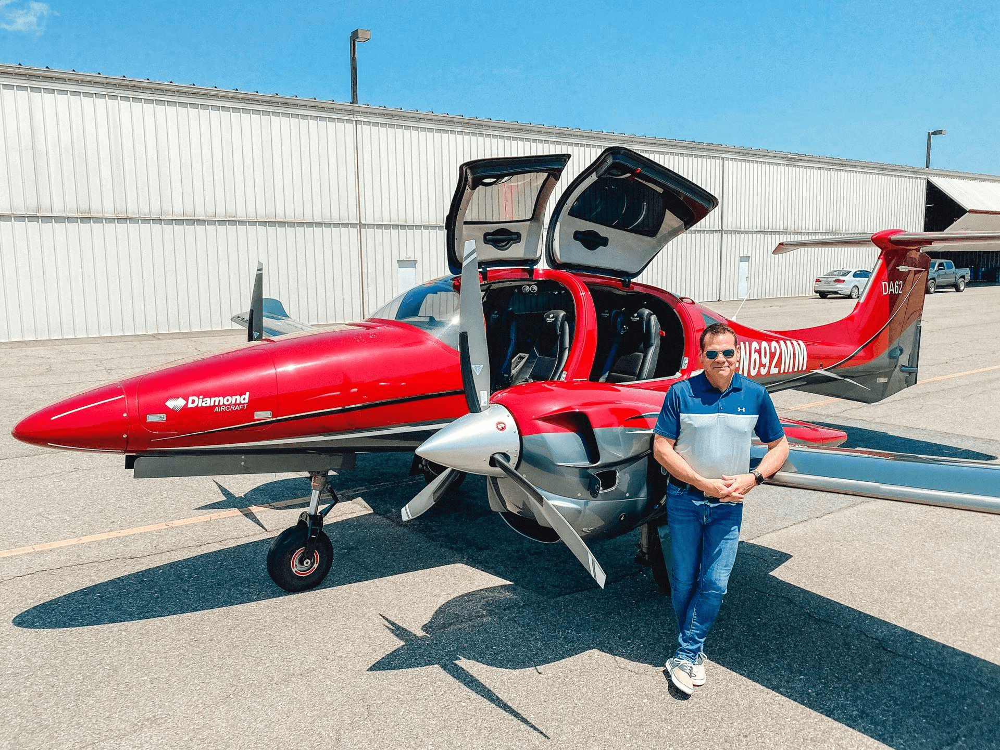

In [84]:
from PIL import Image
from torchvision import transforms

# Load the image
image_path = 'helipad.png'
image = Image.open(image_path)

# Preprocess the image
transform = transforms.Compose([transforms.ToTensor()])
img = transform(image).unsqueeze(0)  # Add batch dimension
image

In [85]:
# Perform object detection

with torch.no_grad():
    pred = model(img)

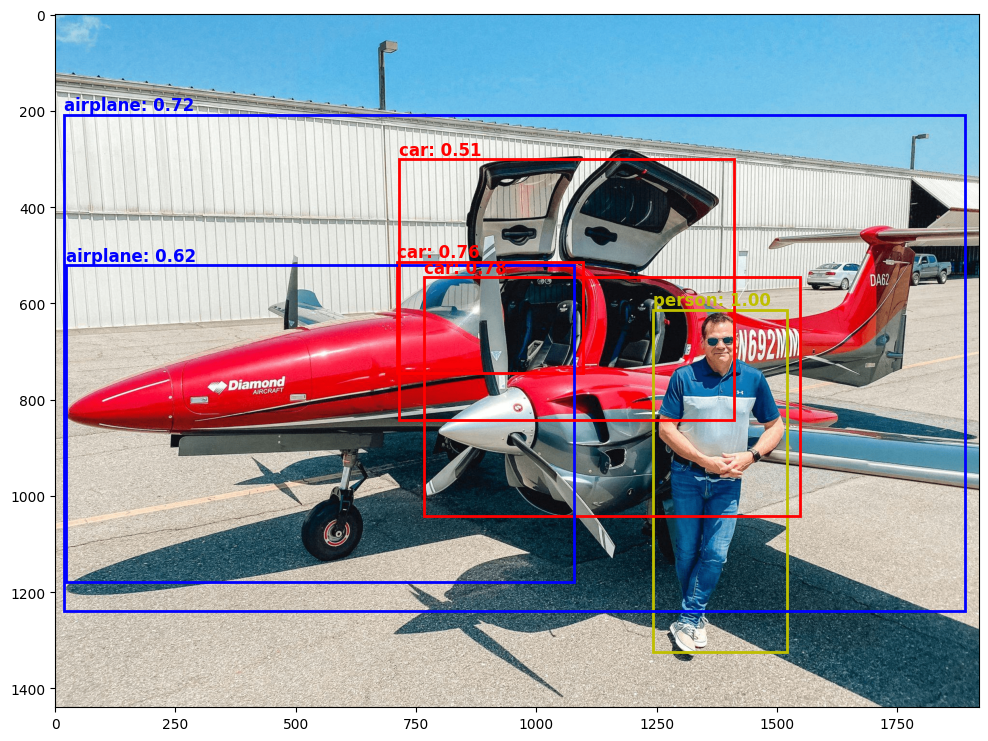

In [86]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Define COCO category names
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'fan', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant',
    'bear', 'zebra', 'giraffe', 'window', 'backpack', 'umbrella', 'fan', 'N/A', 'handbag',
    'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat',
    'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli',
    'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A',
    'dining table', 'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book', 'clock',
    'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Extract bounding boxes, labels, and scores
boxes = pred[0]['boxes'].detach().numpy()
labels = pred[0]['labels'].detach().numpy()
scores = pred[0]['scores'].detach().numpy()

# Set a threshold for detection
threshold = 0.5

# Define colors for different objects
colors = {'car': 'r', 'airplane': 'b', 'person': 'y', 'fan': 'g'}

# Plot the image with bounding boxes
fig, ax = plt.subplots(1, figsize=(12, 9))
ax.imshow(image)

for box, label, score in zip(boxes, labels, scores):
    if score > threshold:
        label_name = COCO_INSTANCE_CATEGORY_NAMES[label]
        if label_name in colors:
            # Draw bounding box
            rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                     linewidth=2, edgecolor=colors[label_name], facecolor='none')
            ax.add_patch(rect)
            # Add label
            ax.text(box[0], box[1] - 10, f'{label_name}: {score:.2f}',
                    color=colors[label_name], fontsize=12, weight='bold')

plt.show()

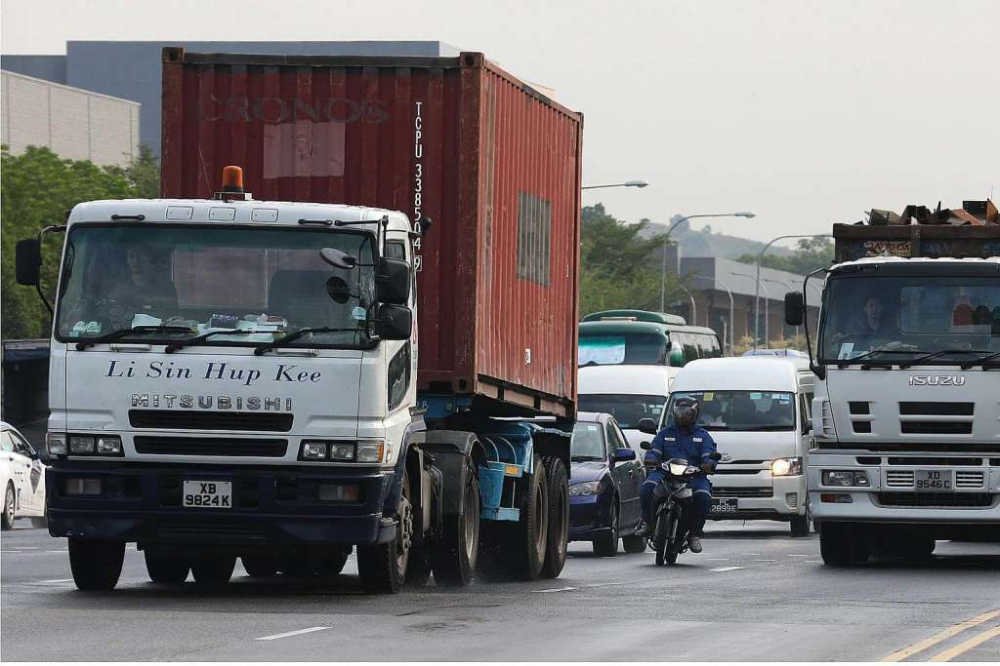

In [96]:
from PIL import Image
from torchvision import transforms

# Load the image
image_path1 = 'singapore_traffic.jpg'
image1 = Image.open(image_path1)

# Preprocess the image
transform = transforms.Compose([transforms.ToTensor()])
img1 = transform(image1).unsqueeze(0)  # Add batch dimension
image1

In [97]:
# Perform object detection

with torch.no_grad():
    pred = model(img1)

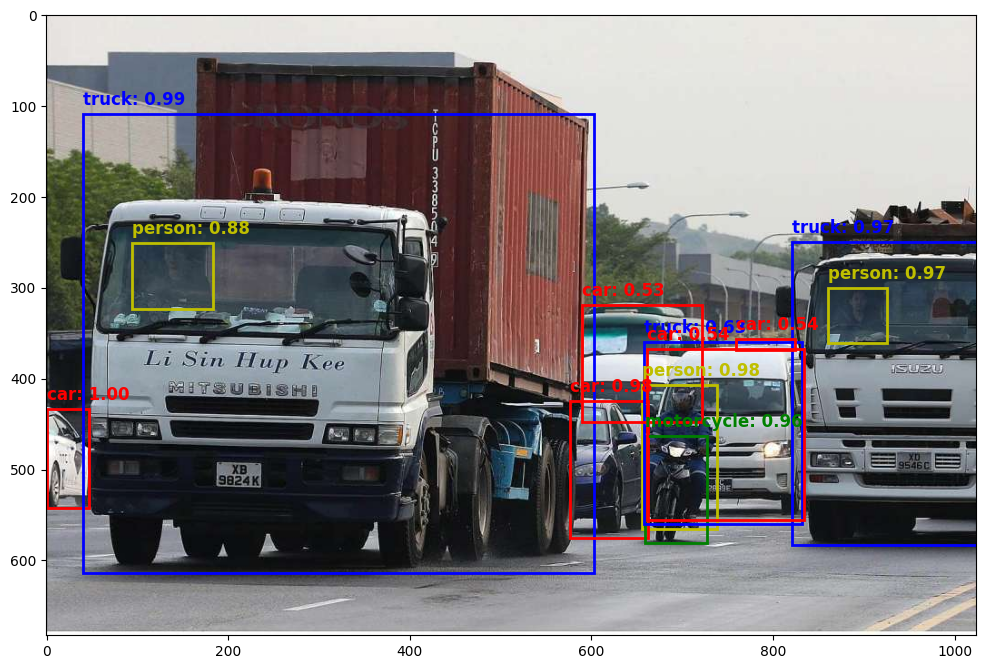

In [98]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Define COCO category names
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'fan', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant',
    'bear', 'zebra', 'giraffe', 'window', 'backpack', 'umbrella', 'fan', 'N/A', 'handbag',
    'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat',
    'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli',
    'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A',
    'dining table', 'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book', 'clock',
    'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Extract bounding boxes, labels, and scores
boxes = pred[0]['boxes'].detach().numpy()
labels = pred[0]['labels'].detach().numpy()
scores = pred[0]['scores'].detach().numpy()

# Set a threshold for detection
threshold = 0.5

# Define colors for different objects
colors = {'car': 'r', 'truck': 'b', 'person': 'y', 'motorcycle': 'g'}

# Plot the image with bounding boxes
fig, ax = plt.subplots(1, figsize=(12, 9))
ax.imshow(image1)

for box, label, score in zip(boxes, labels, scores):
    if score > threshold:
        label_name = COCO_INSTANCE_CATEGORY_NAMES[label]
        if label_name in colors:
            # Draw bounding box
            rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                     linewidth=2, edgecolor=colors[label_name], facecolor='none')
            ax.add_patch(rect)
            # Add label
            ax.text(box[0], box[1] - 10, f'{label_name}: {score:.2f}',
                    color=colors[label_name], fontsize=12, weight='bold')

plt.show()

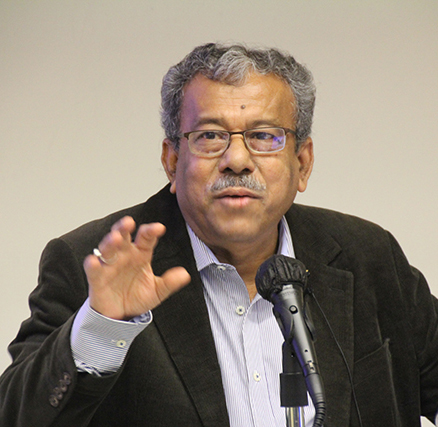

In [130]:
from PIL import Image
from torchvision import transforms

# Load the image
image_path2 = 'Sankar_Kumar_Pal.png'
image2 = Image.open(image_path2)

# Preprocess the image
transform = transforms.Compose([transforms.ToTensor()])
img2 = transform(image2).unsqueeze(0)  # Add batch dimension
image2

In [131]:
# Perform object detection

with torch.no_grad():
    pred = model(img2)

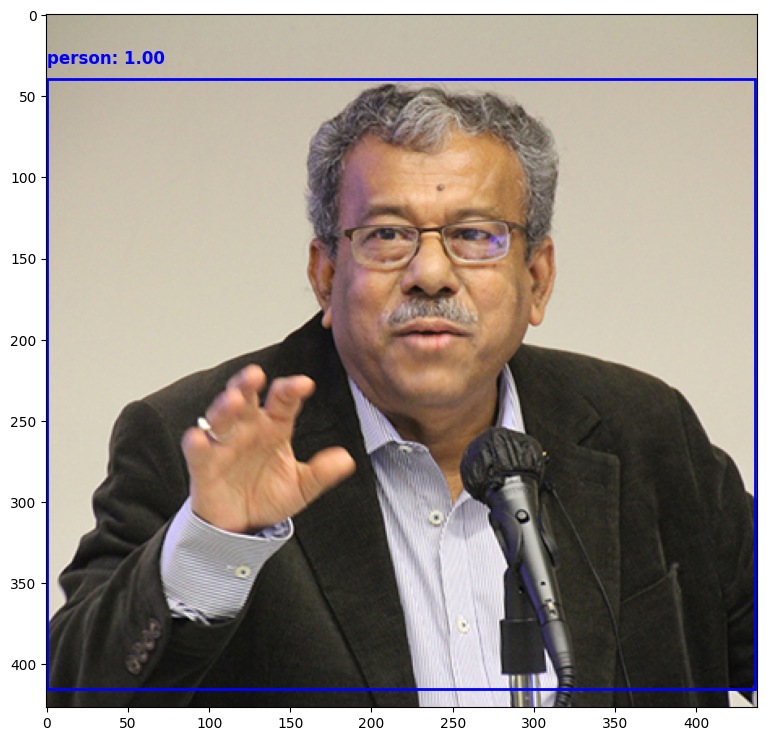

In [133]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Define COCO category names
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'fan', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant',
    'bear', 'zebra', 'giraffe', 'window', 'backpack', 'umbrella', 'fan', 'N/A', 'handbag',
    'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat',
    'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli',
    'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A',
    'dining table', 'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book', 'clock',
    'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Extract bounding boxes, labels, and scores
boxes = pred[0]['boxes'].detach().numpy()
labels = pred[0]['labels'].detach().numpy()
scores = pred[0]['scores'].detach().numpy()

# Set a threshold for detection
threshold = 0.9

# Define colors for different objects
colors = {'person': 'b'}

# Plot the image with bounding boxes
fig, ax = plt.subplots(1, figsize=(12, 9))
ax.imshow(image2)

for box, label, score in zip(boxes, labels, scores):
    if score > threshold:
        label_name = COCO_INSTANCE_CATEGORY_NAMES[label]
        if label_name in colors:
            # Draw bounding box
            rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                     linewidth=2, edgecolor=colors[label_name], facecolor='none')
            ax.add_patch(rect)
            # Add label
            ax.text(box[0], box[1] - 10, f'{label_name}: {score:.2f}',
                    color=colors[label_name], fontsize=12, weight='bold')

plt.show()

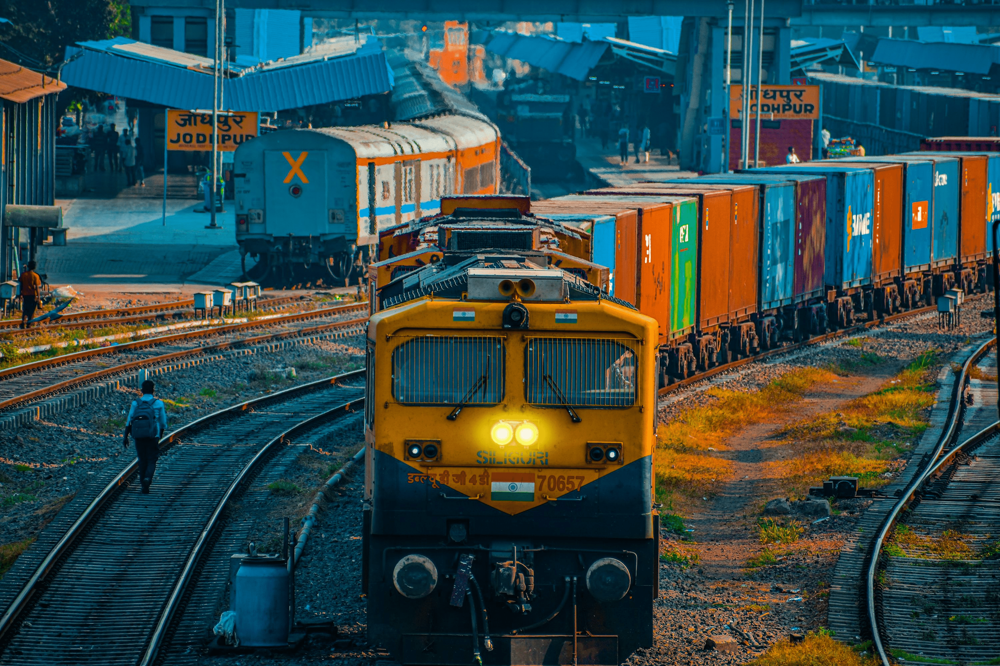

In [152]:
from PIL import Image
from torchvision import transforms

# Load the image
image_path3 = 'irctc.png'
image3 = Image.open(image_path3)

# Preprocess the image
transform = transforms.Compose([transforms.ToTensor()])
img3 = transform(image3).unsqueeze(0)  # Add batch dimension
image3

In [153]:
# Perform object detection

with torch.no_grad():
    pred = model(img3)

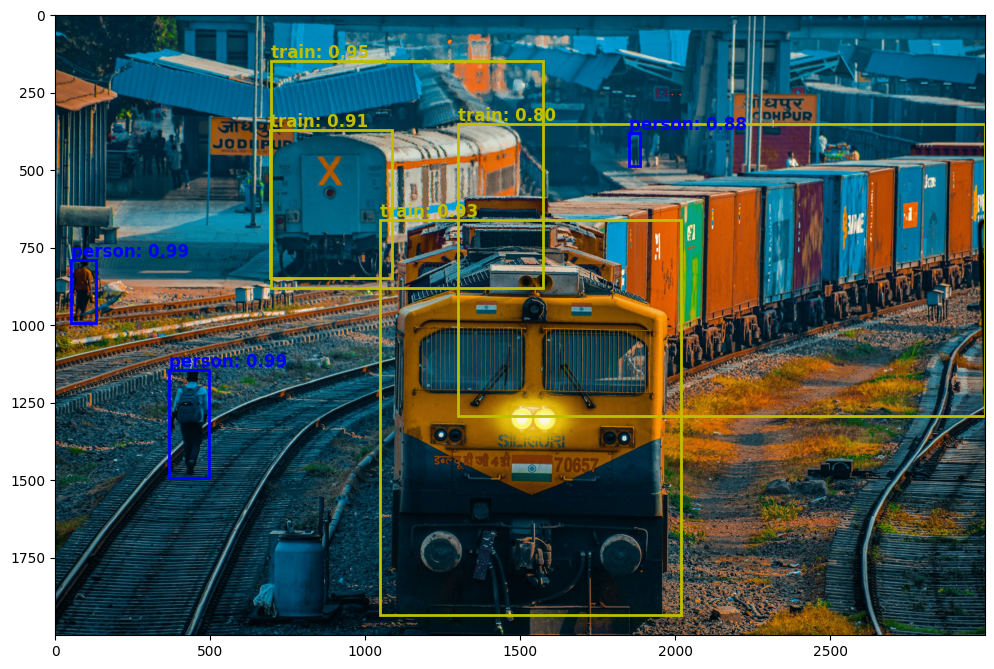

In [155]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Define COCO category names
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'fan', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant',
    'bear', 'zebra', 'giraffe', 'window', 'backpack', 'umbrella', 'fan', 'N/A', 'handbag',
    'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat',
    'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli',
    'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A',
    'dining table', 'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book', 'clock',
    'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Extract bounding boxes, labels, and scores
boxes = pred[0]['boxes'].detach().numpy()
labels = pred[0]['labels'].detach().numpy()
scores = pred[0]['scores'].detach().numpy()

# Set a threshold for detection
threshold = 0.8

# Define colors for different objects
colors = {'train': 'y', 'person': 'b', 'truck': 'r'}

# Plot the image with bounding boxes
fig, ax = plt.subplots(1, figsize=(12, 9))
ax.imshow(image3)

for box, label, score in zip(boxes, labels, scores):
    if score > threshold:
        label_name = COCO_INSTANCE_CATEGORY_NAMES[label]
        if label_name in colors:
            # Draw bounding box
            rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                     linewidth=2, edgecolor=colors[label_name], facecolor='none')
            ax.add_patch(rect)
            # Add label
            ax.text(box[0], box[1] - 10, f'{label_name}: {score:.2f}',
                    color=colors[label_name], fontsize=12, weight='bold')

plt.show()

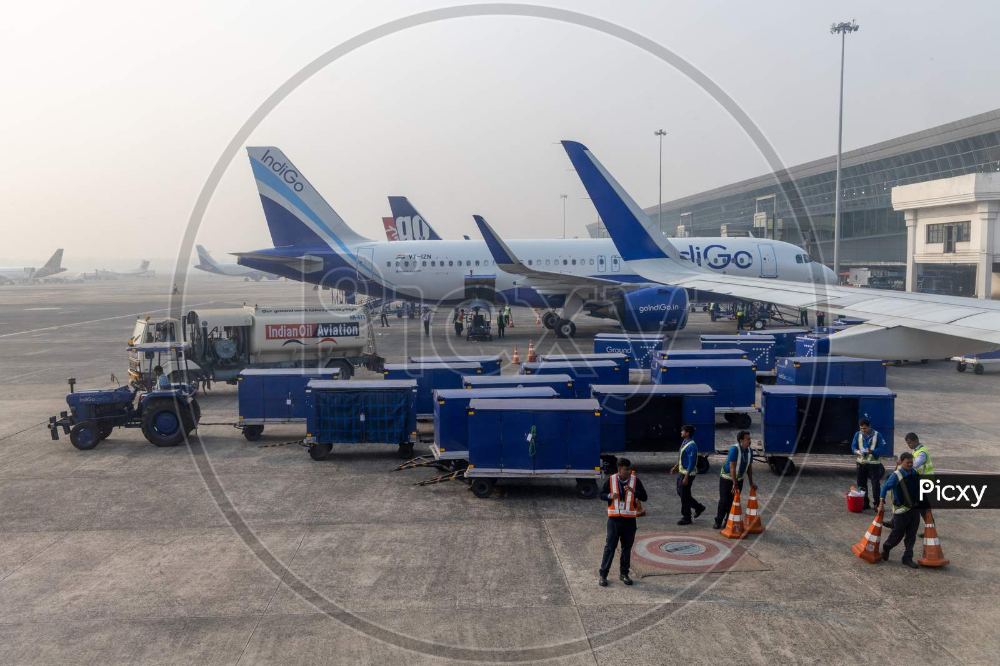

In [149]:
from PIL import Image
from torchvision import transforms

# Load the image
image_path4 = 'kolkata_airport.jpg'
image4 = Image.open(image_path4)

# Preprocess the image
transform = transforms.Compose([transforms.ToTensor()])
img4 = transform(image4).unsqueeze(0)  # Add batch dimension
image4

In [150]:
# Perform object detection

with torch.no_grad():
    pred = model(img4)

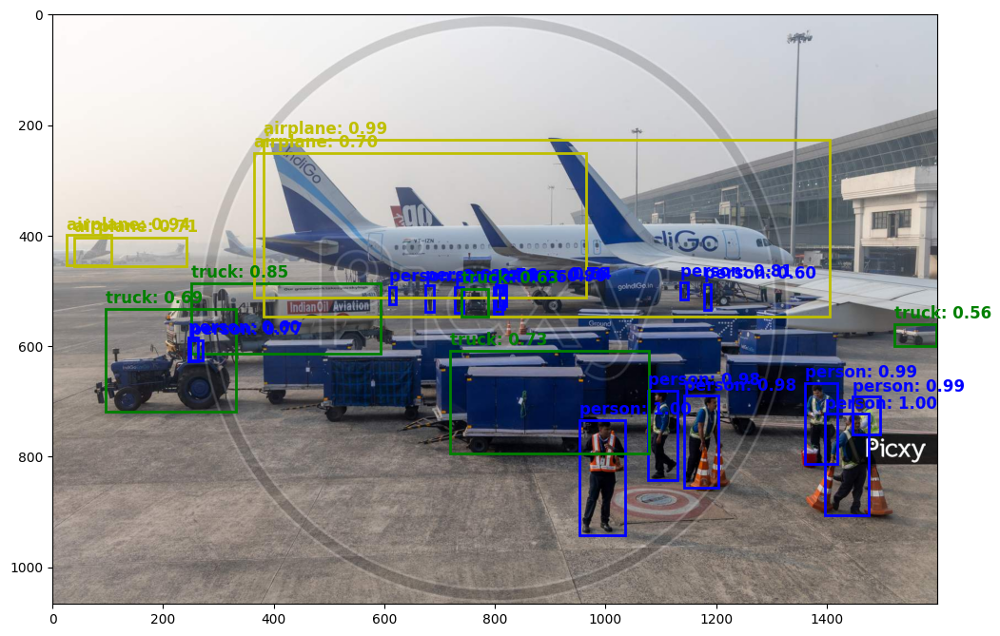

In [151]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Define COCO category names
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'fan', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant',
    'bear', 'zebra', 'giraffe', 'window', 'backpack', 'umbrella', 'fan', 'N/A', 'handbag',
    'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat',
    'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli',
    'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A',
    'dining table', 'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book', 'clock',
    'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Extract bounding boxes, labels, and scores
boxes = pred[0]['boxes'].detach().numpy()
labels = pred[0]['labels'].detach().numpy()
scores = pred[0]['scores'].detach().numpy()

# Set a threshold for detection
threshold = 0.5

# Define colors for different objects
colors = {'airplane': 'y', 'person': 'b', 'truck': 'g'}

# Plot the image with bounding boxes
fig, ax = plt.subplots(1, figsize=(12, 9))
ax.imshow(image4)

for box, label, score in zip(boxes, labels, scores):
    if score > threshold:
        label_name = COCO_INSTANCE_CATEGORY_NAMES[label]
        if label_name in colors:
            # Draw bounding box
            rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                     linewidth=2, edgecolor=colors[label_name], facecolor='none')
            ax.add_patch(rect)
            # Add label
            ax.text(box[0], box[1] - 10, f'{label_name}: {score:.2f}',
                    color=colors[label_name], fontsize=12, weight='bold')

plt.show()

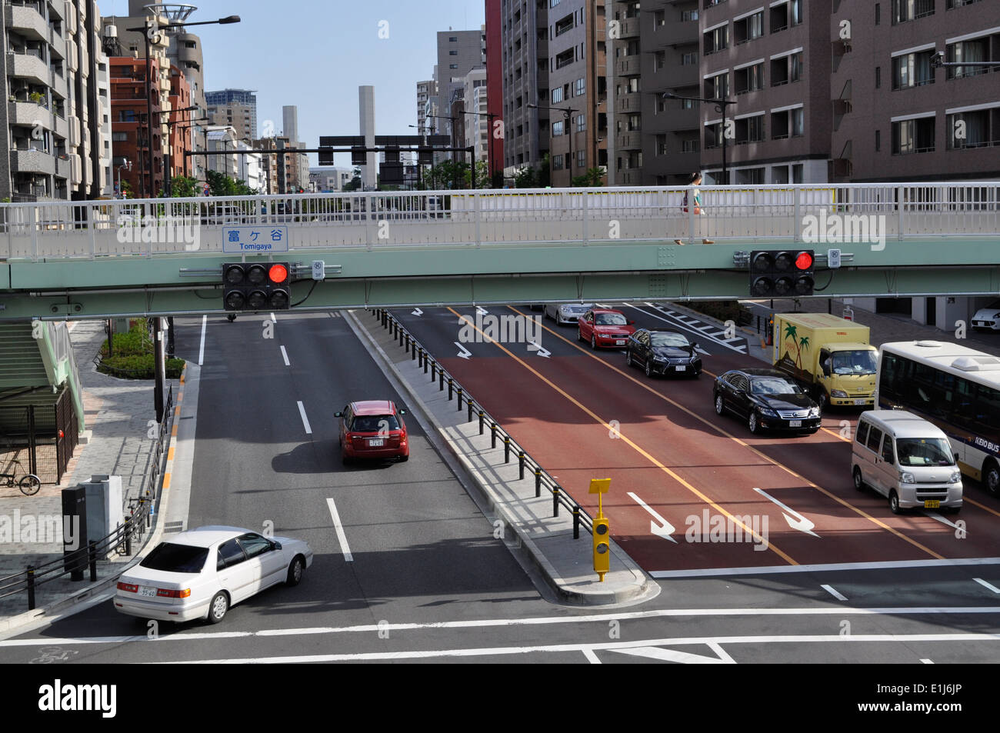

In [157]:
from PIL import Image
from torchvision import transforms

# Load the image
image_path5 = 'tokyo_traffic.jpg'
image5 = Image.open(image_path5)

# Preprocess the image
transform = transforms.Compose([transforms.ToTensor()])
img5 = transform(image5).unsqueeze(0)  # Add batch dimension
image5

In [158]:
# Perform object detection

with torch.no_grad():
    pred = model(img5)

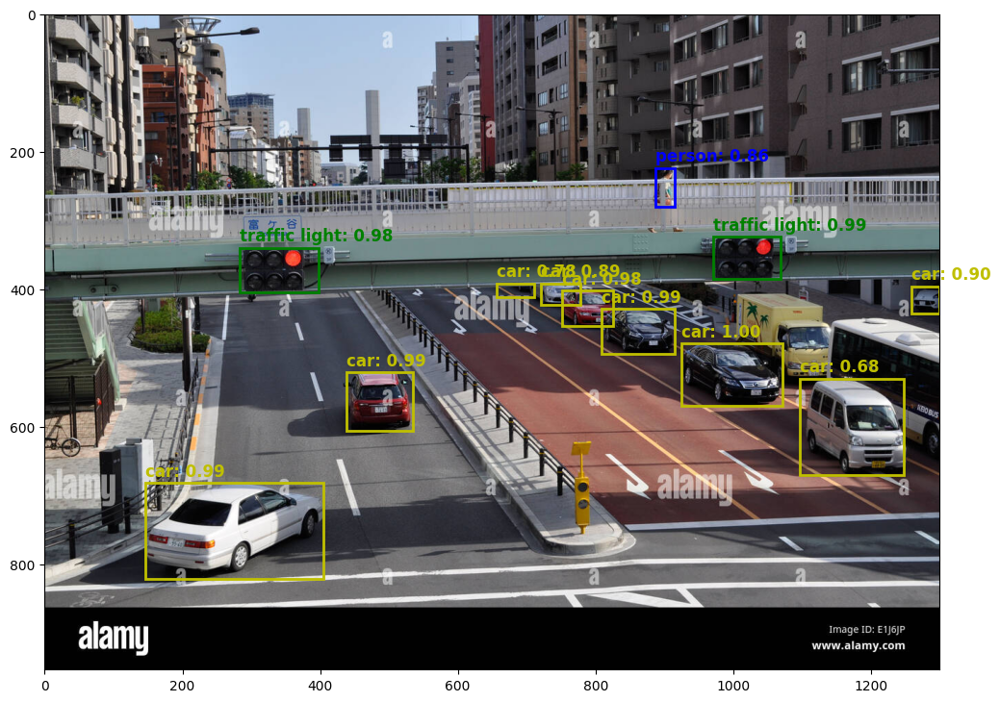

In [162]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Define COCO category names
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'fan', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant',
    'bear', 'zebra', 'giraffe', 'window', 'backpack', 'umbrella', 'fan', 'N/A', 'handbag',
    'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat',
    'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli',
    'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A',
    'dining table', 'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book', 'clock',
    'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Extract bounding boxes, labels, and scores
boxes = pred[0]['boxes'].detach().numpy()
labels = pred[0]['labels'].detach().numpy()
scores = pred[0]['scores'].detach().numpy()

# Set a threshold for detection
threshold = 0.6

# Define colors for different objects
colors = {'car': 'y', 'person': 'b', 'traffic light': 'g'}

# Plot the image with bounding boxes
fig, ax = plt.subplots(1, figsize=(12, 9))
ax.imshow(image5)

for box, label, score in zip(boxes, labels, scores):
    if score > threshold:
        label_name = COCO_INSTANCE_CATEGORY_NAMES[label]
        if label_name in colors:
            # Draw bounding box
            rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                     linewidth=2, edgecolor=colors[label_name], facecolor='none')
            ax.add_patch(rect)
            # Add label
            ax.text(box[0], box[1] - 10, f'{label_name}: {score:.2f}',
                    color=colors[label_name], fontsize=12, weight='bold')

plt.show()

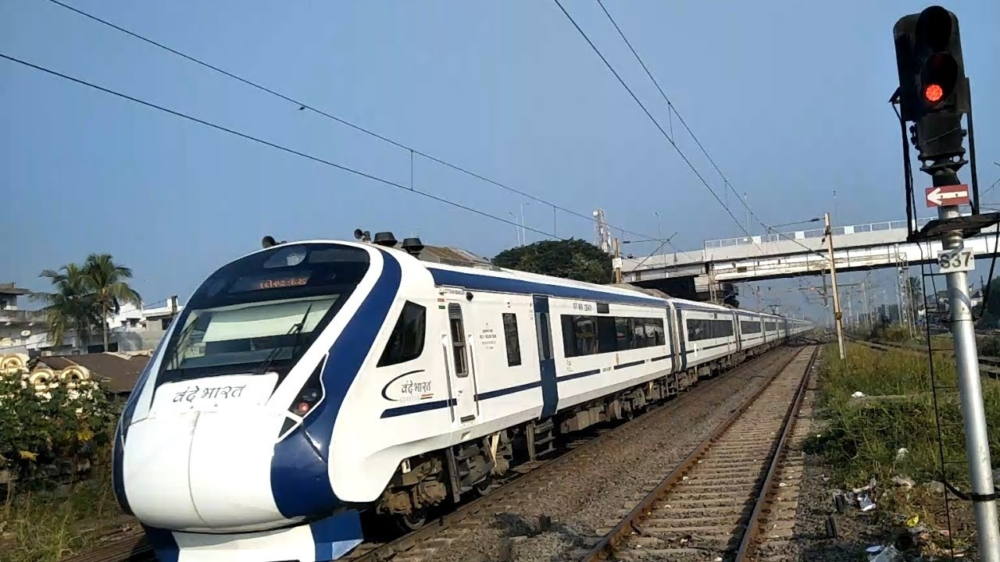

In [165]:
from PIL import Image
from torchvision import transforms

# Load the image
image_path6 = 'vandebharat.jpg'
image6 = Image.open(image_path6)

# Preprocess the image
transform = transforms.Compose([transforms.ToTensor()])
img6 = transform(image6).unsqueeze(0)  # Add batch dimension
image6

In [166]:
# Perform object detection

with torch.no_grad():
    pred = model(img6)

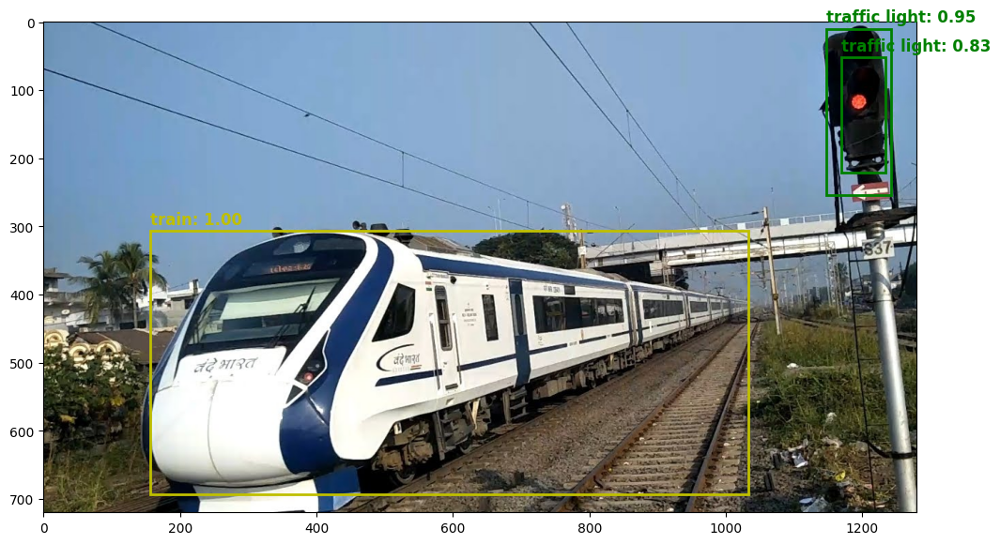

In [171]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Define COCO category names
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'fan', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant',
    'bear', 'zebra', 'giraffe', 'window', 'backpack', 'umbrella', 'fan', 'N/A', 'handbag',
    'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat',
    'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli',
    'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A',
    'dining table', 'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book', 'clock',
    'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Extract bounding boxes, labels, and scores
boxes = pred[0]['boxes'].detach().numpy()
labels = pred[0]['labels'].detach().numpy()
scores = pred[0]['scores'].detach().numpy()

# Set a threshold for detection
threshold = 0.5

# Define colors for different objects
colors = {'train': 'y', 'traffic light': 'g'}

# Plot the image with bounding boxes
fig, ax = plt.subplots(1, figsize=(12, 9))
ax.imshow(image6)

for box, label, score in zip(boxes, labels, scores):
    if score > threshold:
        label_name = COCO_INSTANCE_CATEGORY_NAMES[label]
        if label_name in colors:
            # Draw bounding box
            rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                     linewidth=2, edgecolor=colors[label_name], facecolor='none')
            ax.add_patch(rect)
            # Add label
            ax.text(box[0], box[1] - 10, f'{label_name}: {score:.2f}',
                    color=colors[label_name], fontsize=12, weight='bold')

plt.show()

#### Complete Week 10 Assignment